In [1]:
import pandas as pd
import numpy as np
import json
import folium
import statsmodels.formula.api as sm

import matplotlib.pyplot as plt
%matplotlib inline  
plt.rcParams['figure.figsize'] = (10, 6)

from pandas.plotting import scatter_matrix

In [2]:
income = pd.read_csv('incomeclean.csv')
airasthma = pd.read_csv('airasthma.csv')

In [3]:
airasthma.head()

,Unnamed: 0,index,Year,Zip_Code,Number_of_Asthma_ED_Visits,Age_Adjusted_Rate_of_Asthma_ED_V,Age_Group,County,Daily Max 8-hour Ozone Concentration,DAILY_AQI_VALUE_ozone,Daily Mean PM2.5 Concentration,DAILY_AQI_VALUE
0,0,0,2018,90012,14,36.6,0-17,Los Angeles,0.040017,38.143266,14.530019,52.571566
1,1,1,2018,90012,73,21.6,18+,Los Angeles,0.040017,38.143266,14.530019,52.571566
2,2,2,2018,90012,87,25.5,All Ages,Los Angeles,0.040017,38.143266,14.530019,52.571566
3,3,3,2018,90221,176,96.9,0-17,Los Angeles,0.038434,35.726761,13.372807,49.157895
4,4,4,2018,90221,230,58.5,18+,Los Angeles,0.038434,35.726761,13.372807,49.157895


In [4]:
agegroup = airasthma['Age_Group'] == 'All Ages'
airasthma = airasthma[agegroup]

In [5]:
airasthma.drop(['Unnamed: 0', 'index', 'Age_Group'], axis = 1, inplace = True)
airasthma.tail()

,Year,Zip_Code,Number_of_Asthma_ED_Visits,Age_Adjusted_Rate_of_Asthma_ED_V,County,Daily Max 8-hour Ozone Concentration,DAILY_AQI_VALUE_ozone,Daily Mean PM2.5 Concentration,DAILY_AQI_VALUE
437,2015,93535,926,119.8,Los Angeles,0.055594,68.966197,9.891254,38.715084
439,2015,90293,27,26.2,Los Angeles,0.042839,41.025862,9.891254,38.715084
441,2015,92230,17,54.6,Riverside,0.055228,66.063063,9.858257,37.944954
443,2015,92325,64,89.9,San Bernardino,0.055866,70.420613,8.017825,32.709970
444,2015,92401,58,323.4,San Bernardino,0.054187,67.740634,10.693458,40.542056


In [6]:
airasthma.rename(columns={'Number_of_Asthma_ED_Visits': 'ED_Visits', 'Age_Adjusted_Rate_of_Asthma_ED_V': 'Asthma Age Adj Rate',
                          'Daily Max 8-hour Ozone Concentration': 'Daily Max 8hr Ozone', 'DAILY_AQI_VALUE_ozone': 'Daily AQI Ozone', 
                          'Daily Mean PM2.5 Concentration' : 'Daily Mean PM2.5'}, inplace=True)

In [7]:
income.head()

,Unnamed: 0,Zip Code,City,County,Income
0,0,90001,Los Angeles,Los Angeles,35976.98061
1,1,90002,Los Angeles,Los Angeles,35976.98061
2,2,90003,Los Angeles,Los Angeles,35976.98061
3,3,90004,Los Angeles,Los Angeles,35976.98061
4,4,90005,Los Angeles,Los Angeles,35976.98061


In [8]:
income.rename(columns={'Zip Code': 'Zip_Code'}, inplace=True)
income.drop(['Unnamed: 0'], axis = 1, inplace=True)

In [9]:
merged = pd.merge(income, airasthma, on=['Zip_Code', 'County'], how = 'inner')
merged.head()

,Zip_Code,City,County,Income,Year,ED_Visits,Asthma Age Adj Rate,Daily Max 8hr Ozone,Daily AQI Ozone,Daily Mean PM2.5,DAILY_AQI_VALUE
0,90012,Los Angeles,Los Angeles,35976.98061,2018,87,25.5,0.040017,38.143266,14.530019,52.571566
1,90012,Los Angeles,Los Angeles,35976.98061,2017,84,27.3,0.044026,45.189655,13.986102,51.419205
2,90012,Los Angeles,Los Angeles,35976.98061,2016,73,26.1,0.041295,40.227528,13.331976,49.774157
3,90012,Los Angeles,Los Angeles,35976.98061,2015,62,24.3,0.043310,43.198324,14.470782,52.384590
4,90221,Compton,Los Angeles,32263.57895,2018,406,68.4,0.038434,35.726761,13.372807,49.157895


In [10]:
merged['Income'].median()
merged['Income'] = merged['Income'].fillna(merged['Income'].median())
merged.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 124 entries, 0 to 123
Data columns (total 11 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Zip_Code             124 non-null    int64  
 1   City                 124 non-null    object 
 2   County               124 non-null    object 
 3   Income               124 non-null    float64
 4   Year                 124 non-null    int64  
 5   ED_Visits            124 non-null    int64  
 6   Asthma Age Adj Rate  124 non-null    float64
 7   Daily Max 8hr Ozone  124 non-null    float64
 8   Daily AQI Ozone      124 non-null    float64
 9   Daily Mean PM2.5     124 non-null    float64
 10  DAILY_AQI_VALUE      124 non-null    float64
dtypes: float64(6), int64(3), object(2)
memory usage: 10.7+ KB


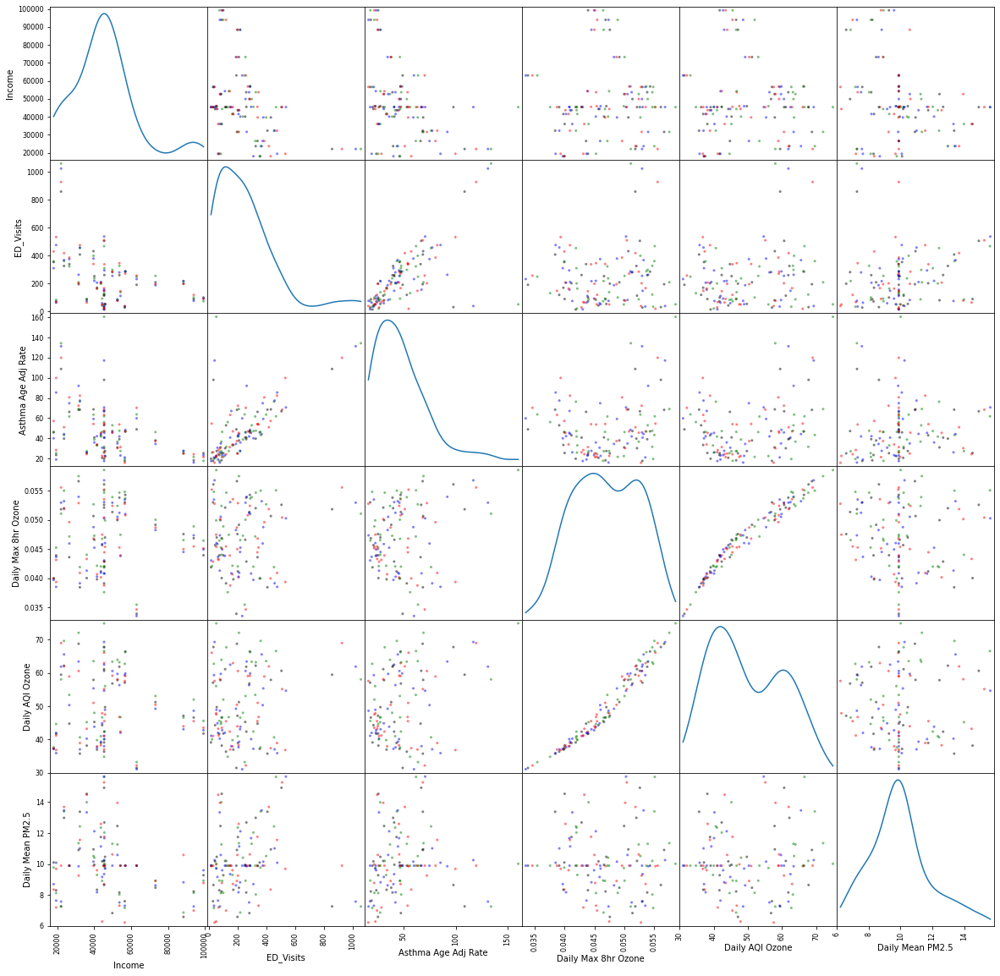

In [11]:
#scatter matrix after na values are filled in with median
colors = merged["Year"].map({2015: 'red', 2016: 'blue', 2017: 'green', 2018:'black'})
data = merged[['Income', 'ED_Visits', 'Asthma Age Adj Rate', 'Daily Max 8hr Ozone', 'Daily AQI Ozone', 
               'Daily Mean PM2.5']]
scatter_matrix(data, figsize=(20,20), diagonal='kde', color=colors)
plt.show()

In [12]:
naairasthma = pd.read_csv('airasthma_withna.csv')
naairasthma.head()

,Unnamed: 0,index,Year,Zip_Code,Number_of_Asthma_ED_Visits,Age_Adjusted_Rate_of_Asthma_ED_V,Age_Group,County,Daily Max 8-hour Ozone Concentration,DAILY_AQI_VALUE_ozone,Daily Mean PM2.5 Concentration,DAILY_AQI_VALUE
0,0,0,2018,90012,14,36.6,0-17,Los Angeles,0.040017,38.143266,14.530019,52.571566
1,1,1,2018,90012,73,21.6,18+,Los Angeles,0.040017,38.143266,14.530019,52.571566
2,2,2,2018,90012,87,25.5,All Ages,Los Angeles,0.040017,38.143266,14.530019,52.571566
3,3,3,2018,90221,176,96.9,0-17,Los Angeles,0.038434,35.726761,13.372807,49.157895
4,4,4,2018,90221,230,58.5,18+,Los Angeles,0.038434,35.726761,13.372807,49.157895


In [13]:
#agegroup = naairasthma['Age_Group'] == 'All Ages'
#naairasthma = naairasthma[agegroup]

naairasthma.drop(['Unnamed: 0', 'index'], axis = 1, inplace = True)

In [14]:
naairasthma.rename(columns={'Number_of_Asthma_ED_Visits': 'ED_Visits', 'Age_Adjusted_Rate_of_Asthma_ED_V': 'Asthma Age Adj',
                          'Daily Max 8-hour Ozone Concentration': 'Daily Max 8hr Ozone', 'DAILY_AQI_VALUE_ozone': 'Daily AQI Ozone', 
                          'Daily Mean PM2.5 Concentration' : 'Daily Mean PM2.5'}, inplace=True)

In [15]:
namerged = pd.merge(income, naairasthma, on='Zip_Code', how = 'inner')
namerged.head()

,Zip_Code,City,County_x,Income,Year,ED_Visits,Asthma Age Adj,Age_Group,County_y,Daily Max 8hr Ozone,Daily AQI Ozone,Daily Mean PM2.5,DAILY_AQI_VALUE
0,90012,Los Angeles,Los Angeles,35976.98061,2018,14,36.6,0-17,Los Angeles,0.040017,38.143266,14.530019,52.571566
1,90012,Los Angeles,Los Angeles,35976.98061,2018,73,21.6,18+,Los Angeles,0.040017,38.143266,14.530019,52.571566
2,90012,Los Angeles,Los Angeles,35976.98061,2018,87,25.5,All Ages,Los Angeles,0.040017,38.143266,14.530019,52.571566
3,90012,Los Angeles,Los Angeles,35976.98061,2017,13,37.2,0-17,Los Angeles,0.044026,45.189655,13.986102,51.419205
4,90012,Los Angeles,Los Angeles,35976.98061,2017,71,23.8,18+,Los Angeles,0.044026,45.189655,13.986102,51.419205


In [16]:
namerged.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 358 entries, 0 to 357
Data columns (total 13 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Zip_Code             358 non-null    int64  
 1   City                 358 non-null    object 
 2   County_x             358 non-null    object 
 3   Income               320 non-null    float64
 4   Year                 358 non-null    int64  
 5   ED_Visits            358 non-null    int64  
 6   Asthma Age Adj       358 non-null    float64
 7   Age_Group            358 non-null    object 
 8   County_y             358 non-null    object 
 9   Daily Max 8hr Ozone  358 non-null    float64
 10  Daily AQI Ozone      358 non-null    float64
 11  Daily Mean PM2.5     292 non-null    float64
 12  DAILY_AQI_VALUE      292 non-null    float64
dtypes: float64(6), int64(3), object(4)
memory usage: 33.6+ KB


In [17]:
namerged.dropna(axis=0, inplace=True)
namerged.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 260 entries, 0 to 354
Data columns (total 13 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Zip_Code             260 non-null    int64  
 1   City                 260 non-null    object 
 2   County_x             260 non-null    object 
 3   Income               260 non-null    float64
 4   Year                 260 non-null    int64  
 5   ED_Visits            260 non-null    int64  
 6   Asthma Age Adj       260 non-null    float64
 7   Age_Group            260 non-null    object 
 8   County_y             260 non-null    object 
 9   Daily Max 8hr Ozone  260 non-null    float64
 10  Daily AQI Ozone      260 non-null    float64
 11  Daily Mean PM2.5     260 non-null    float64
 12  DAILY_AQI_VALUE      260 non-null    float64
dtypes: float64(6), int64(3), object(4)
memory usage: 24.4+ KB


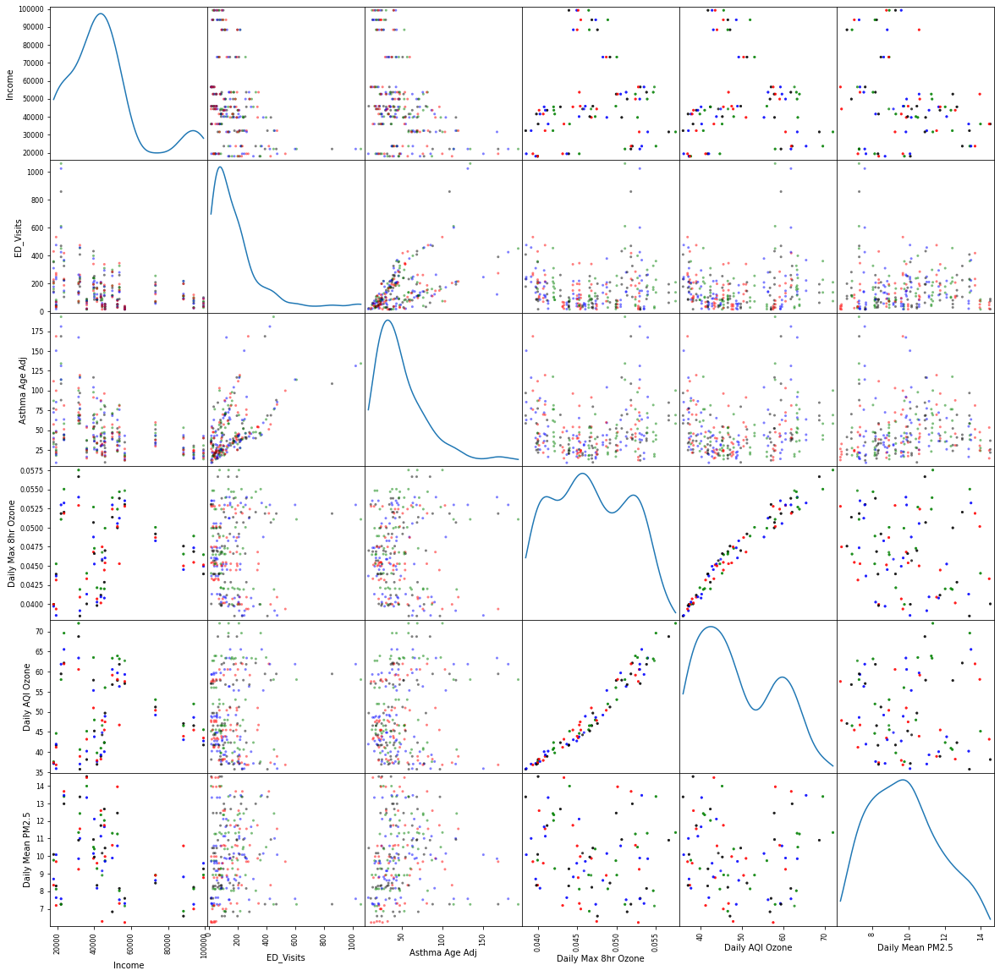

In [18]:
#scatter matrix after na values are dropped
colors = namerged["Year"].map({2015: 'red', 2016: 'blue', 2017: 'green', 2018:'black'})
data = namerged[['Income', 'ED_Visits', 'Asthma Age Adj', 'Daily Max 8hr Ozone', 'Daily AQI Ozone', 
               'Daily Mean PM2.5']]
scatter_matrix(data, figsize=(20,20), diagonal='kde', color=colors)
plt.show()

In [19]:
merged.to_csv('alldata.csv')
namerged.to_csv('alldata_withna.csv')

In [20]:
with open('zip-code-tabulation-areas.geojson') as jsonFile:
    data = json.load(jsonFile)

#reference: https://towardsdatascience.com/visualizing-data-at-the-zip-code-level-with-folium-d07ac983db20

In [21]:
namerged['Zip_Code'] = namerged['Zip_Code'].astype(str)
m = folium.Map([34.0522, -118.2437], zoom_start = 10)
folium.Choropleth(geo_data='zip-code-tabulation-areas.geojson', data = namerged, columns=['Zip_Code', 'Income'], 
                  key_on = 'feature.properties.external_id', fill_opacity=0.7, line_weight=0.5, 
                  fill_color = 'RdYlGn', nan_fill_color='white').add_to(m)
m

In [22]:
income['Zip_Code'] = income['Zip_Code'].astype(str)
m = folium.Map([34.0522, -118.2437], zoom_start = 10)
folium.Choropleth(geo_data='zip-code-tabulation-areas.geojson', data = income, columns=['Zip_Code', 'Income'], 
                  key_on = 'feature.properties.external_id', fill_opacity=0.7, line_weight=0.5, 
                  fill_color = 'RdYlGn', nan_fill_color='white').add_to(m)
m

In [24]:
m = folium.Map([34.0522, -118.2437], zoom_start = 10)
folium.Choropleth(geo_data='zip-code-tabulation-areas.geojson', data = namerged, columns=['Zip_Code', 'ED_Visits'], 
                  key_on = 'feature.properties.external_id', fill_opacity=0.7, line_weight=0.5, 
                  fill_color = 'GnBu', nan_fill_color='white').add_to(m)
m

In [25]:
asthma_ols = sm.ols(formula='ED_Visits ~ Income', data = merged).fit()
asthma_ols.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              ED_Visits   R-squared:                       0.151
Model:                            OLS   Adj. R-squared:                  0.144
Method:                 Least Squares   F-statistic:                     21.70
Date:                Fri, 23 Apr 2021   Prob (F-statistic):           8.19e-06
Time:                        13:58:25   Log-Likelihood:                -817.34
No. Observations:                 124   AIC:                             1639.
Df Residuals:                     122   BIC:                             1644.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept    408.5256     41.244      9.905      0.000     326.880     490.172
Income        -0.0037      0.001     -4.658      0.000      -0.005      -0.002
==============================================================================
Omnibus:                       45.030   Durbin-Watson:                   0.445
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              116.713
Skew:                           1.404   Prob(JB):                     4.53e-26
Kurtosis:                       6.834   Cond. No.                     1.32e+05
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.32e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [29]:
merged.rename(columns={'Daily Mean PM2.5': 'Daily_Mean_PM2.5'}, inplace=True)

In [28]:
asthma_ols = sm.ols(formula='ED_Visits ~ Income + Daily_Mean_PM2.5', data = merged).fit()
asthma_ols.summary()

SyntaxError: invalid syntax (<unknown>, line 1)